# <div align="center">Prédiction de conversions à une Newsletter</div>



## 🔍 Instructions détaillées
> 📝 Les instructions complètes du projet sont disponibles dans le fichier [project_instructions.md](./src/project_instructions.md)



## 🎯 Objectif
> *Déterminer si l'utilisateur d'un site internet va être "converti", c'est-à-dire s'il va s'abonner à la newsletter du site internet qu'il visite.*



## 🛠️ Comment ?
> Pour répondre à cette problématique de classification, nous devons entrainer plusieurs modèles de ML Supervisé afin de déterminer le meilleur F1.



## 📊 Quelle métrique préférer ?
Le F1 est la métrique demandée dans ce projet. C'est effectivement la plus pertinente dans ce cas de figure de jeux de données déséquilibrés (beaucoup plus de non conversion que de conversion), le F1-score prenant en compte la performance sur la classe minoritaire.

**Pour rappel:**
- F1 = (2 * (Precision * Recall) / (Precision + Recall))
- Moyenne harmonique entre :
- Precision : % de vrais positifs parmi les prédictions positives
- Recall : % de vrais positifs effectivement identifiés

> ***Note importante:*** *L'accurancy (taux de bonne prédictions, de manière générale) est donc peu pertinante car il sera assez aisé pour tout modèle de prévoir un très grand nombre de 'non-convertis'. Et donc un très fort taux d'accurrency, même si il ne détecte aucune conversion, en ne répétant que la classe majoritaire, sans rien apprendre*



## 🏆 Mode "Kaggle competition"
> Ce projet s'inscrit dans un contexte de 'compétition' interne à la promo. Pour déterminer quel modèle parvient à obtenir les meilleures prédictions sur un échantillon de données livré de manière non labellisée (à l'aveugle / sans connaître les résultats de la variable test)



---



In [2]:
# Analyze
import pandas as pd
import numpy as np

# ML
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import (
    accuracy_score, f1_score, classification_report, precision_recall_curve,
    confusion_matrix, ConfusionMatrixDisplay, recall_score, precision_score
)

# Viz
import plotly.express as px
import matplotlib.pyplot as plt



---


## EDA



---


In [3]:
# Chargement des données
df = pd.read_csv("src/conversion_data_train.csv")

In [4]:
# Affichage des premières lignes pour comprendre la structure
df.head()

,country,age,new_user,source,total_pages_visited,converted
0,China,22,1,Direct,2,0
1,UK,21,1,Ads,3,0
2,Germany,20,0,Seo,14,1
3,US,23,1,Seo,3,0
4,US,28,1,Direct,3,0


Nous avons une structure simple : des nouveaux utilisateurs (ou pas), originaires d'un pays, qui arrivent sur le site via une source, qui ont visité un certain nombre de pages et qui se sont inscrits à la newsletter (converted=1).


In [5]:
# Informations sur les types de données et valeurs manquantes
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284580 entries, 0 to 284579
Data columns (total 6 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   country              284580 non-null  object
 1   age                  284580 non-null  int64 
 2   new_user             284580 non-null  int64 
 3   source               284580 non-null  object
 4   total_pages_visited  284580 non-null  int64 
 5   converted            284580 non-null  int64 
dtypes: int64(4), object(2)
memory usage: 13.0+ MB


Aucune donnée manquante sur 284580 entrées

In [6]:
# Statistiques descriptives
df.describe(include='all')

,country,age,new_user,source,total_pages_visited,converted
count,284580,284580.000000,284580.000000,284580,284580.000000,284580.000000
unique,4,NaN,NaN,3,NaN,NaN
top,US,NaN,NaN,Seo,NaN,NaN
freq,160124,NaN,NaN,139477,NaN,NaN
mean,NaN,30.564203,0.685452,NaN,4.873252,0.032258
std,NaN,8.266789,0.464336,NaN,3.341995,0.176685
min,NaN,17.000000,0.000000,NaN,1.000000,0.000000
25%,NaN,24.000000,0.000000,NaN,2.000000,0.000000
50%,NaN,30.000000,1.000000,NaN,4.000000,0.000000
75%,NaN,36.000000,1.000000,NaN,7.000000,0.000000


Le describe nous permet de constater le déséquilibre des classes : seulement 3,22 % de convertis.

In [7]:
# Distribution de la variable cible en valeurs absolues
df['converted'].value_counts()
print(df['converted'].value_counts())

converted
0    275400
1      9180
Name: count, dtype: int64


In [8]:
# Taux de converti en pourcentage par rapport au total global
fig = px.pie(df, names='converted', title='Taux de conversion')
fig.show()

Analysons la structure des différentes features afin de bien comprendre nos données :

In [ ]:
# Distribution de l'age
fig = px.histogram(df, x="age", title="Distribution de l'âge")
fig.show()

La distribution de l'âge suit une distribution normale centrée autour de 30 ans, avec quelques outliers au-delà de 80 ans qui nécessiteront un traitement

In [ ]:
# Distribution du nombre de pages visitées
fig = px.histogram(df, x="total_pages_visited", title="Distribution du nombre de pages visitées")
fig.show()

Un concentration sur 1-7 pages.

In [ ]:
# Distribution géographique des utilisateurs
fig = px.histogram(df, x="country", title="Distribution des utilisateurs par pays")
fig.show()

Les États-Unis représentent la majorité du trafic, suivi par la Chine. Cette information sera importante pour la stratégie marketing.

In [ ]:
# Canaux d'acquisition des utilisateurs
fig = px.histogram(df, x="source", title="Distribution des utilisateurs par source")
fig.show()

Le principal pourvoyeur est le référencement naturel (SEO)

En analysant les différentes catégories, nous avons pu constater des outliers/valeur abérentes. Spécifiquement dans l'âge des utilisateurs. Analysons çà pljus précisement :

In [13]:
# boxplot "Age"
fig = px.box(df, y="age", title="Distribution de l'âge")
fig.show()

In [14]:
# Nolbre d'outlier selon la règle de Tukey
Q1 = df["age"].quantile(0.25)
Q3 = df["age"].quantile(0.75)
IQR = Q3 - Q1
outliers = df[(df["age"] < Q1 - 1.5 * IQR) | (df["age"] > Q3 + 1.5 * IQR)]
print(f"Nombre d'outliers : {outliers.shape[0]}")

Nombre d'outliers : 1369


Cela fait un certain nombre d'outliers...supprimer tous ces points signifierait perdre beaucoup de données potentiellement valides. Nous ne supprimerons que les valeurs au delà de 90 ans (donc 2 outliers..) C'est un seuil max, raisonnable pour un utilisateur internet. Les âges au-delà sont plus susceptibles d'être des erreurs de saisie.

Pour terminer, analysons l'impact de chaque variable sur la conversion des utilisateurs

In [15]:
# Conversions selon l'âge
fig = px.histogram(df, x="age", color="converted", 
                  title="Répartition des conversions selon l'âge",
                  barmode="overlay")
fig.show()

In [16]:
# conversions par pays
fig = px.histogram(df, x="country", color="converted", 
                  title="Répartition des conversions par pays",
                  barmode="overlay")
fig.show()

In [17]:
# Conversions selon la source
fig = px.histogram(df, x="source", color="converted", 
                  title="Répartition des conversions par source",
                  barmode="overlay")
fig.show()

In [18]:
# Calculer le pourcentage de conversion par source
conversion_source = df.groupby("source")["converted"].mean().reset_index()
conversion_source = conversion_source.sort_values("converted", ascending=False)
print(conversion_source)


   source  converted
0     Ads   0.034801
2     Seo   0.032873
1  Direct   0.027814


In [19]:
# Conversions selon le nombre de pages visitées
fig = px.histogram(df, x="total_pages_visited", color="converted", 
                  title="Répartition des conversions selon le nombre de pages visitées",
                  barmode="overlay")
fig.show()

In [ ]:
# Conversions nouveaux vs anciens utilisateurs
fig = px.histogram(df, x="new_user", color="converted", 
                  title="Répartition des conversions selon le type d'utilisateur",
                  barmode="overlay")
fig.show()

In [ ]:
# Scatter matrix pour visualiser les relations entre variables
fig = px.scatter_matrix(df,
                        dimensions=["age", "new_user", "total_pages_visited"],
                        color="converted", 
                        color_continuous_scale=px.colors.sequential.Viridis,
                        title="Matrix de relation avec distinction des conversions")

# Améliorer la lisibilité
fig.update_layout(
    dragmode='select', # Permettre sélection de points
    width=800, # Largeur du graph
    height=800, # Hauteur du graph
    hovermode='closest' # Afficher les informations au survol le plus proche
)

fig.show()

## Synthèse de l'Analyse Exploratoire des Données (EDA)




### Analyse  :
- Les pages visitées sont fortement corrélées à la conversion :  plus les utilisateurs visitent le site, plus ils sont susceptibles de convertir.
- Deux sources semblent plus performantes en termes de conversion (par exemple, `Ads` en terme de %)
- Les pays ont des taux de conversion variés.
- Des valeurs atypiques ont été identifiées dans les variables numériques (ex. : `age` > 90), ce qui nécessite des ajustements pendant le prétraitement.




### Recommandations business issues de l'EDA :
- Prioriser l'engagement des utilisateurs (via les pages visitées) pour améliorer les conversions.
- Adapter les stratégies en fonction des pays les plus performants.
- Selon le coût, se concentrer sur les sources Ads (% de conversion le plus importants) et les SEO (nombre le plus importants de convertis)
- Tenir compte des valeurs atypiques dans les modèles pour éviter qu'elles ne biaisent les prédictions.



---


## PREPROCESSING



---

In [22]:
# vérification du shape avant de supprimer les outliers
df.shape

(284580, 6)

In [23]:
# suppression des outliers extrèmes, supérieur à 100 dans la colonne age sur un nouveau df
df_cleaned = df[df["age"] <= 90]

In [24]:
# vérification du shape après suppression des outliers
df_cleaned.shape

(284578, 6)

C'est correct !

In [25]:
#renommer le df pour la suite (plus rapide!)
df = df_cleaned

# Création de la varibale cible
target_variable = "converted"

# # Séparation features (X) et target (y)
X = df.drop(target_variable, axis = 1)
y = df.loc[:, target_variable]

In [26]:
# Split train/test
# Nous gardons 15% pour le test car nous avons beaucoup de données. random_state à 42 pour la reproductibilité
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.15, random_state=42)

In [27]:
# Création du pipeline de preprocessing : numériques et catégorielles
numeric_features = ['age', 'total_pages_visited']
categorical_features = ['country', 'source', 'new_user']

In [28]:
# Création du pipeline de preprocessing : numériques et catégorielles
numeric_features = ['age', 'total_pages_visited']
categorical_features = ['country', 'source', 'new_user']

# pipeline pour les variables numériques.
## une seule étape : standardisation des données. pas d'imputer car pas de valeurs manquantes
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())])

# pipeline pour les variables catégorielles.
## ne seule étape : encodage. pas de SimpleImputer car pas de valeurs manquantes
categorical_transformer = Pipeline(steps=[
    ('encoder', OneHotEncoder(drop='first'))
])

# Combinaison des pipelines dans ColumnTransformer
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

# Application du preprocessing
X_train_processed = preprocessor.fit_transform(X_train)
X_test_processed = preprocessor.transform(X_test)



---

## Modélisation et évaluation


---


In [29]:
# Stockage des résultats pour comparaison
results = {}

Commençons par un modèle simple comme référence.


Modèle 1: Régression Logistique Baseline
Train F1:  0.76137339055794
Test F1:  0.7721221613155834
Train Recall :  0.6860899832409436
Test Recall :  0.6938775510204082
Train Precision :  0.8552145267555841
Test Precision :  0.8702559576345984
F1-Score moyen en validation croisée : 0.7605075917527275
Standard deviation : 0.007320789004559761


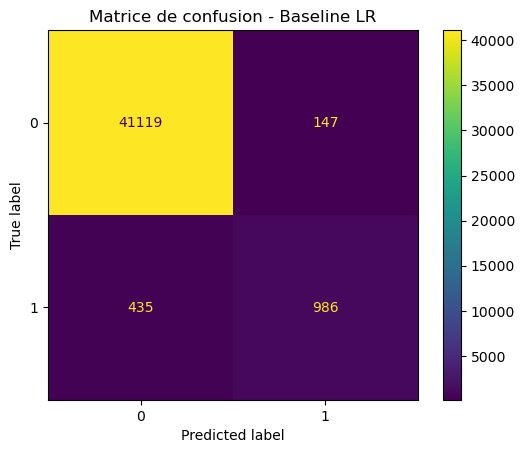

In [30]:
# Modèle 1: Régression Logistique Baseline
# --------------------------------------
print("\nModèle 1: Régression Logistique Baseline")

# Initialize the logistic regression classifier
lr1 = LogisticRegression()
lr1.fit(X_train_processed, y_train)

# Predictions on train et test set
y_train_pred_lr1 = lr1.predict(X_train_processed)
y_test_pred_lr1 = lr1.predict(X_test_processed)

# Stockage des résultats
results['Baseline LR'] = {
    'train_f1': f1_score(y_train, y_train_pred_lr1),
    'test_f1': f1_score(y_test, y_test_pred_lr1),
    'train_recall': recall_score(y_train, y_train_pred_lr1),
    'test_recall': recall_score(y_test, y_test_pred_lr1),
    'train_precision': precision_score(y_train, y_train_pred_lr1),
    'test_precision': precision_score(y_test, y_test_pred_lr1)
}

# Affichage résultats
print("Train F1: ", results['Baseline LR']['train_f1'])
print("Test F1: ", results['Baseline LR']['test_f1'])
print ("Train Recall : ", recall_score(y_train, y_train_pred_lr1))
print ("Test Recall : ", recall_score(y_test, y_test_pred_lr1))
print ("Train Precision : ", precision_score(y_train, y_train_pred_lr1))
print ("Test Precision : ", precision_score(y_test, y_test_pred_lr1))

# Perform cross-validation
cv_scores = cross_val_score(lr1, X_train_processed, y_train, cv=5, scoring='f1')
print(f"F1-Score moyen en validation croisée : {cv_scores.mean()}")
print(f"Standard deviation : {cv_scores.std()}")

# Calcul de la matrice de confusion pour le test set
cm = confusion_matrix(y_test, y_test_pred_lr1)

# Affichage de la matrice de confusion
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=lr1.classes_)
disp.plot(cmap='viridis')
plt.title("Matrice de confusion - Baseline LR")
plt.show()


- Excellente performance pour identifier les non-conversions (41119)
- Un très faible taux de faux positifs (147)
- Un taux modéré de faux négatifs (435)
- Une bonne capacité à identifier les vraies conversions

CCL : Ce modèle est déjà prerformant et une très bonne précision reflétée par seulement 147 faux positifs. Il parvient également à identifier 986 vraies conversions, même si 435 lui échappent, ce qui est compréhensible étant donné le fort déséquilibre des classes.

Essayons maintenant d'améliorer un peu ce modèle via une Gridsearch avec quelques hyperparametres et un seuil de décision optimisé.


Modèle 2: Régression Logistique Optimisée
Recherche des meilleurs hyperparamètres...
Meilleurs hyperparamètres trouvés : {'C': 5, 'max_iter': 42, 'penalty': 'l1', 'solver': 'saga'}
Meilleur f1-score CV : 0.7610722499218074
Seuil optimal trouvé : 0.407
Train F1:  0.7677989130434782
Test F1:  0.7869822485207101
Train Recall :  0.7285032873533582
Test Recall :  0.7487684729064039
Train Precision :  0.8115754703432428
Test Precision :  0.8293063133281372
F1-Score moyen en validation croisée pour lr2 : 0.7610722499218074
Standard deviation pour lr2 : 0.007399385422264383


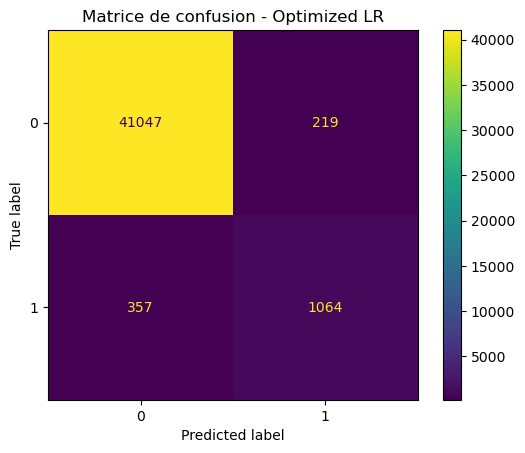

In [31]:
# Modèle 2: Régression Logistique Optimisée avec GridSearch
# ---------------------------------------
print("\nModèle 2: Régression Logistique Optimisée")

# Définition de la grille d'hyperparamètres
param_grid = {
    'C': [1, 2, 5],
    'penalty': ['l1'],
    'max_iter': [42, 44, 48],
    'solver': ['saga']
}

# GridSearch avec validation croisée
print("Recherche des meilleurs hyperparamètres...")
log_reg = LogisticRegression()
grid_search = GridSearchCV(log_reg, param_grid, cv=5, scoring='f1')
grid_search.fit(X_train_processed, y_train)

# Affichage des résultats de la recherche
print(f"Meilleurs hyperparamètres trouvés : {grid_search.best_params_}")
print(f"Meilleur f1-score CV : {grid_search.best_score_}")

# Utilisation du meilleur modèle trouvé
lr2 = grid_search.best_estimator_


# Optimisation du seuil de décision
# Calcul des probabilités de la classe positive pour l'ensemble d'entraînement et de test
y_train_proba_lr2 = lr2.predict_proba(X_train_processed)[:, 1]
y_test_proba_lr2 = lr2.predict_proba(X_test_processed)[:, 1]

# Trouver le meilleur seuil pour l'ensemble d'entraînement
precision, recall, thresholds = precision_recall_curve(y_train, y_train_proba_lr2)
f1_scores = 2 * recall * precision / (recall + precision)
best_threshold = thresholds[np.argmax(f1_scores[:-1])]
print(f"Seuil optimal trouvé : {best_threshold:.3f}")

# Application du seuil optimisé
y_train_pred_lr2 = (lr2.predict_proba(X_train_processed)[:, 1] >= best_threshold).astype(int)
y_test_pred_lr2 = (lr2.predict_proba(X_test_processed)[:, 1] >= best_threshold).astype(int)

# Stockage des résultats
results['Optimized LR'] = {
    'train_f1': f1_score(y_train, y_train_pred_lr2),
    'test_f1': f1_score(y_test, y_test_pred_lr2),
    'train_recall': recall_score(y_train, y_train_pred_lr2),
    'test_recall': recall_score(y_test, y_test_pred_lr2),
    'train_precision': precision_score(y_train, y_train_pred_lr2),
    'test_precision': precision_score(y_test, y_test_pred_lr2)
}

# Affichage des résultats
print("Train F1: ", results['Optimized LR']['train_f1'])
print("Test F1: ", results['Optimized LR']['test_f1'])
print ("Train Recall : ", recall_score(y_train, y_train_pred_lr2))
print ("Test Recall : ", recall_score(y_test, y_test_pred_lr2))
print ("Train Precision : ", precision_score(y_train, y_train_pred_lr2))
print ("Test Precision : ", precision_score(y_test, y_test_pred_lr2))

# Perform cross-validation for the optimized logistic regression model
cv_scores_lr2 = cross_val_score(lr2, X_train_processed, y_train, cv=5, scoring='f1')
print(f"F1-Score moyen en validation croisée pour lr2 : {cv_scores_lr2.mean()}")
print(f"Standard deviation pour lr2 : {cv_scores_lr2.std()}")

# créer matrice de confusion pour le test set
cm = confusion_matrix(y_test, y_test_pred_lr2)

# Affichage de la matrice de confusion
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=lr2.classes_)
disp.plot(cmap='viridis')
plt.title("Matrice de confusion - Optimized LR")
plt.show()

L'optimisation du seuil a permis d'améliorer le recall (74.8%) tout en maintenant une bonne précision (82.9%), traduisant un meilleur compromis.

Nous avons donc pour ce modèle :
- Légère baisse des vrais négatifs
- Augmentation des faux positifs
- Meilleure détection des conversions
- Réduction importante des faux négatifs

On voit clairement l'effet de l'optimisation du seuil : le modèle est plus "agressif" dans la prédiction des conversions, ce qui se traduit par :
- Plus de vrais positifs détectés (meilleur recall)
- Une légère augmentation des faux positifs (baisse de précision)
- Un meilleur équilibre général, confirmé par le F1-score supérieur

Cette optimisation est particulièrement pertinente si manquer une conversion (faux négatif) est plus coûteux que prédire une fausse conversion (faux positif).

Enfin, essayons avec un modèle plus complexe capable de capturer des relations non-linéaires : une random forest basique avec quelques valeurs uniques


Modèle 3: Random Forest
Train F1:  0.7694282047625838
Test F1:  0.759592795614722
Train Recall :  0.6956297537707877
Test Recall :  0.6826178747361014
Train Precision :  0.8607433402456532
Test Precision :  0.8561341571050309
F1-Score moyen en validation croisée pour rf : 0.7562806284910214
Standard deviation pour rf : 0.009273476025859059


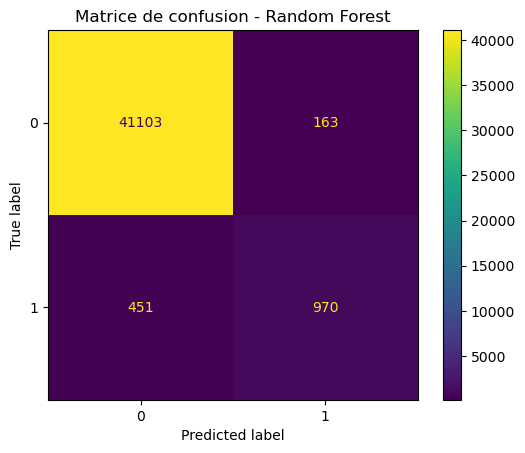

In [32]:
# Modèle 3: Random Forest
# --------------------------------------
print("\nModèle 3: Random Forest")

rf = RandomForestClassifier(
    max_depth=50,           # Profondeur maximale des arbres
    min_samples_split=50,   # Nombre minimum d'échantillons pour splitter
    n_estimators=40,        # Nombre d'arbres
    min_samples_leaf=2,     # Nombre minimum d'échantillons par feuille
)
rf.fit(X_train_processed, y_train)

y_train_pred_rf = rf.predict(X_train_processed)
y_test_pred_rf = rf.predict(X_test_processed)

# Stockage des résultats
results['Random Forest'] = {
    'train_f1': f1_score(y_train, y_train_pred_rf),
    'test_f1': f1_score(y_test, y_test_pred_rf),
    'train_recall': recall_score(y_train, y_train_pred_rf),
    'test_recall': recall_score(y_test, y_test_pred_rf),
    'train_precision': precision_score(y_train, y_train_pred_rf),
    'test_precision': precision_score(y_test, y_test_pred_rf)
}

# Affichage des résultats
print("Train F1: ", results['Random Forest']['train_f1'])
print("Test F1: ", results['Random Forest']['test_f1'])
print ("Train Recall : ", recall_score(y_train, y_train_pred_rf))
print ("Test Recall : ", recall_score(y_test, y_test_pred_rf))
print ("Train Precision : ", precision_score(y_train, y_train_pred_rf))
print ("Test Precision : ", precision_score(y_test, y_test_pred_rf))

# Perform cross-validation for the optimized logistic regression model
cv_scores_rf = cross_val_score(rf, X_train_processed, y_train, cv=5, scoring='f1')
print(f"F1-Score moyen en validation croisée pour rf : {cv_scores_rf.mean()}")
print(f"Standard deviation pour rf : {cv_scores_rf.std()}")

# créer matrice de confusion pour le test set
cm = confusion_matrix(y_test, y_test_pred_rf)

# Affichage de la matrice de confusion
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=rf.classes_)
disp.plot(cmap='viridis')
plt.title("Matrice de confusion - Random Forest")
plt.show()

Une performance assez similaire au modèle de base avec une précision légèrement supérieure (85.6%) mais un recall plus faible (68.2%).

Nous pourrions dire que le Random Forest se positionne entre les deux versions de la régression logistique :
- Meilleure précision que la LR optimisée (moins de faux positifs)
- Mais moins bon recall (plus de faux négatifs)
- Performance globale proche de la baseline LR

En résumé, la complexité accrue du Random Forest n'apporte pas d'amélioration significative. Il tend à être plus conservateur dans ses prédictions que la LR optimisée, ce qui n'est pas forcément souhaitable dans ce contexte de forte asymétrie des classes.


---

## Analyse finale et comparative des modèles


---

In [33]:
# Tableau final des performances

# avec F1, Precision et Recall de Baseline LR, Optimized LR et Random Forest
results_df = pd.DataFrame.from_dict(results, orient='index')

# Affichage amélioré du tableau comparatif des performances
print("\nComparaison des performances:")
print(results_df.to_string())


Comparaison des performances:
               train_f1   test_f1  train_recall  test_recall  train_precision  test_precision
Baseline LR    0.761373  0.772122      0.686090     0.693878         0.855215        0.870256
Optimized LR   0.767799  0.786982      0.728503     0.748768         0.811575        0.829306
Random Forest  0.769428  0.759593      0.695630     0.682618         0.860743        0.856134





### Forces et Faiblesses


Régression Logistique Baseline
- ➕ Excellente précision (0.870)
- ➕ Simple et interprétable
- ➖ Recall plus faible (0.694)


Régression Logistique Optimisée
- ➕ Meilleur équilibre global (F1 le plus élevé)
- ➕ Amélioration significative du recall (0.749)
- ➖ Légère baisse de précision par rapport au baseline


Random Forest
- ➕ Bonne précision (0.856)
- ➖ Recall le plus faible (0.682)
- ➖ Complexité accrue sans gain de performance




---


## Conclusion et recommandations



---


### Sur le modèle choisi :
La régression logistique optimisée émerge comme le meilleur choix pour plusieurs raisons :
1. Meilleur F1-Score global (0.787)
2. Augmentation significative du recall sans trop sacrifier la précision
3. Meilleur compromis entre complexité et performance

Cette supériorité s'explique principalement par :
- L'optimisation du seuil de décision
- Le choix approprié des hyperparamètres
- La bonne gestion du déséquilibre des classes




### Recommandations Business
1. Recommandations Opérationnelles
- Optimiser l'expérience utilisateur pour augmenter le nombre de pages visitées
- Focus sur l'acquisition via SEO qui montre les meilleurs taux de conversion
- Adapter la stratégie marketing selon les zones géographiques

2. Choix Stratégiques selon le Contexte Business
- Contexte actuel : Modèle optimisé recommandé (meilleur équilibre général)

- Scénarios alternatifs :
* Si coût élevé des faux positifs (ex: investissement marketing conséquent par prospect)
→ Privilégier le modèle baseline (précision de 0.870)
* Si coût élevé des conversions manquées (ex: perte de clients à forte valeur)
→ Conserver le modèle optimisé (recall de 0.749)

3. Adaptation du Modèle
- Réévaluer régulièrement le coût business des faux positifs vs faux négatifs
- Ajuster le seuil de décision en fonction de l'évolution des priorités business
- Monitorer l'impact des changements de stratégie sur les métriques de conversion




### Recommandations Techniques

Pistes d'Amélioration Techniques :
- Hyperparamétrage avancé du Random Forest via GridSearchCV
- Test d'un modèle plus sophistiqués par exemple XGBoost (performant sur données déséquilibrées)
- Techniques de rééquilibrage des classes via SMOTE (Synthetic Minority Over-sampling Technique)
- Feature Engineering (variables d'interaction, ou binning)



---


## Sauvegarde du CSV pour test à l'aveugle



---


In [36]:
# Pour transmission et publication du résultat dans le tableau du concours
# import du data_test
test = pd.read_csv('src/conversion_data_test.csv')
print('Prediction set (without labels) :', test.shape)
# Préparation des features
features_list = ['age', 'total_pages_visited', 'country', 'new_user', 'source']
X_without_labels = test.loc[:, features_list]
# Application du même preprocessing que sur le train
test_processed = preprocessor.transform(test)

# Prédiction des probabilités et application du seuil optimisé
test_probabilities = lr2.predict_proba(test_processed)[:, 1]
predictions = (test_probabilities >= best_threshold).astype(int)

# les stocker en csv
#Bien suivre la regle de comment nommer le csv -> conversiondata_test_predictions{name}-{model}.csv
predictions_df = pd.DataFrame(predictions, columns=['Prediction'])
predictions_df.to_csv('predictions/conversion_data_test_predictions_ROM1L-logisticregression2corr.csv', index=False)

Prediction set (without labels) : (31620, 5)
